In [1]:
#py
#CONDA ENV: base_conda
#Import packages
#---------------------------------------
import sys
import os
import glob
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
import scanpy as sc
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"

#Import your modules
#---------------------------------------
sys.path.insert(1, '/cndd3/dburrows/CODE/admin_tools/')
from admin_tools import admin_functions as adm


# Define paths
#----------------------------------------------------------------------
l_code = '/Users/dominicburrows/Dropbox/PhD/Analysis/my_scripts/GitHub/'
l_data = '/Users/dominicburrows/Dropbox/PhD/analysis/Project/'
l_fig = '/Users/dominicburrows/Dropbox/PhD/figures/'

s_code = '/cndd3/dburrows/CODE/'
s_data = '/cndd3/dburrows/DATA/'
s_fig = '/cndd3/dburrows/FIGS/'

%load_ext autoreload
sys.version

'3.9.7 | packaged by conda-forge | (default, Sep 29 2021, 19:23:11) \n[GCC 9.4.0]'

In [1]:
#R
library(Seurat)
library(SeuratData)
library(cowplot)
library(dplyr)

Warning message:
“package ‘Seurat’ was built under R version 4.2.3”
The legacy packages maptools, rgdal, and rgeos, underpinning the sp package,
which was just loaded, will retire in October 2023.
Please refer to R-spatial evolution reports for details, especially
https://r-spatial.org/r/2023/05/15/evolution4.html.
It may be desirable to make the sf package available;
package maintainers should consider adding sf to Suggests:.
The sp package is now running under evolution status 2
     (status 2 uses the sf package in place of rgdal)

Attaching SeuratObject

Warning message:
“package ‘cowplot’ was built under R version 4.2.3”

Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [2]:
# Load in data for R
#---------------------------------------
#seurat read rds object
pfc <- readRDS(file = '/cndd3/dburrows/DATA/singlecell_HIVOUD/pfc_lt.rds')

In [4]:
pfc

An object of class Seurat 
156845 features across 118677 samples within 4 assays 
Active assay: ATAC (50000 features, 50000 variable features)
 3 other assays present: RNA, RNA_raw, SCT
 7 dimensional reductions calculated: pca, harmony.rna, umap.rna, lsi, harmony.atac, umap.atac, umap.wnn

In [2]:
# Load in data for scanpy
#---------------------------------------
rna_data = sc.read_h5ad('/cndd3/dburrows/DATA/singlecell_HIVOUD/RNA_230828_PFC_13samples_HVWs_combined.h5ad')
atac_data = sc.read_h5ad('/cndd3/dburrows/DATA/singlecell_HIVOUD/ATAC_230828_PFC_13samples_HVWs_combined.h5ad')

In [3]:
rna_data

AnnData object with n_obs × n_vars = 118677 × 36611
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'nCount_ATAC', 'nFeature_ATAC', 'gex_raw_reads', 'gex_mapped_reads', 'gex_conf_intergenic_reads', 'gex_conf_exonic_reads', 'gex_conf_intronic_reads', 'gex_conf_exonic_unique_reads', 'gex_conf_exonic_antisense_reads', 'gex_conf_exonic_dup_reads', 'gex_exonic_umis', 'gex_conf_intronic_unique_reads', 'gex_conf_intronic_antisense_reads', 'gex_conf_intronic_dup_reads', 'gex_intronic_umis', 'gex_conf_txomic_unique_reads', 'gex_umis_count', 'gex_genes_count', 'atac_raw_reads', 'atac_unmapped_reads', 'atac_lowmapq', 'atac_dup_reads', 'atac_chimeric_reads', 'atac_mitochondrial_reads', 'atac_fragments', 'atac_TSS_fragments', 'atac_peak_region_fragments', 'atac_peak_region_cutsites', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'SCT.weight', 'ATAC.weight', 'wsnn_res.0.2', 'seurat_clusters', 'log_nCount_ATAC', 'log_nCount_

In [4]:
atac_data

AnnData object with n_obs × n_vars = 118677 × 50000
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'nCount_RNA_raw', 'nFeature_RNA_raw', 'nCount_ATAC', 'nFeature_ATAC', 'gex_raw_reads', 'gex_mapped_reads', 'gex_conf_intergenic_reads', 'gex_conf_exonic_reads', 'gex_conf_intronic_reads', 'gex_conf_exonic_unique_reads', 'gex_conf_exonic_antisense_reads', 'gex_conf_exonic_dup_reads', 'gex_exonic_umis', 'gex_conf_intronic_unique_reads', 'gex_conf_intronic_antisense_reads', 'gex_conf_intronic_dup_reads', 'gex_intronic_umis', 'gex_conf_txomic_unique_reads', 'gex_umis_count', 'gex_genes_count', 'atac_raw_reads', 'atac_unmapped_reads', 'atac_lowmapq', 'atac_dup_reads', 'atac_chimeric_reads', 'atac_mitochondrial_reads', 'atac_fragments', 'atac_TSS_fragments', 'atac_peak_region_fragments', 'atac_peak_region_cutsites', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'SCT.weight', 'ATAC.weight', 'wsnn_res.0.2', 'seurat_clusters', 'log_nCount_ATAC', 'log_nCount_

# Visualise coarse dimensionality reduction + clustering

In [5]:
rna_data.obs.columns.unique

<bound method Index.unique of Index(['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt',
       'nCount_RNA_raw', 'nFeature_RNA_raw', 'nCount_ATAC', 'nFeature_ATAC',
       'gex_raw_reads', 'gex_mapped_reads', 'gex_conf_intergenic_reads',
       'gex_conf_exonic_reads', 'gex_conf_intronic_reads',
       'gex_conf_exonic_unique_reads', 'gex_conf_exonic_antisense_reads',
       'gex_conf_exonic_dup_reads', 'gex_exonic_umis',
       'gex_conf_intronic_unique_reads', 'gex_conf_intronic_antisense_reads',
       'gex_conf_intronic_dup_reads', 'gex_intronic_umis',
       'gex_conf_txomic_unique_reads', 'gex_umis_count', 'gex_genes_count',
       'atac_raw_reads', 'atac_unmapped_reads', 'atac_lowmapq',
       'atac_dup_reads', 'atac_chimeric_reads', 'atac_mitochondrial_reads',
       'atac_fragments', 'atac_TSS_fragments', 'atac_peak_region_fragments',
       'atac_peak_region_cutsites', 'TSS.enrichment', 'TSS.percentile',
       'nCount_SCT', 'nFeature_SCT', 'SCT.weight', 'ATAC.weight',

In [9]:
rna_data.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,nCount_RNA_raw,nFeature_RNA_raw,nCount_ATAC,nFeature_ATAC,gex_raw_reads,gex_mapped_reads,...,log_nCount_SCT,log_nFeature_ATAC,log_nFeature_SCT,library,wsnn_res.0.25,remove_cells,sub.cluster,value,assigned_celltype,condition
CG103_PFC_hiv_AAACAGCCAATAACCT-1,SeuratProject,21451.0,6040,5.556850,22724.0,6405,27482.0,11190,84533,78891,...,8.335911,9.322776,7.826443,CG103,11,0,2,1.0,L2/3,OUD+HIV
CG103_PFC_hiv_AAACAGCCAATAGTCT-1,SeuratProject,2042.0,1226,12.047013,2140.0,1281,2093.0,1002,8459,7927,...,8.154788,6.909753,7.111512,CG103,20,0,7,1.0,OPC,OUD+HIV
CG103_PFC_hiv_AAACAGCCACAGCCTG-1,SeuratProject,2068.0,1210,2.949710,2150.0,1260,2284.0,1023,7730,7239,...,8.153062,6.930495,7.098376,CG103,0,0,1,1.0,Oligo,OUD+HIV
CG103_PFC_hiv_AAACAGCCACTAGCGT-1,SeuratProject,2761.0,1473,0.144875,2886.0,1554,632.0,309,11192,10606,...,8.157657,5.733341,7.295056,CG103,0,0,1,1.0,Oligo,OUD+HIV
CG103_PFC_hiv_AAACAGCCATTGCGTA-1,SeuratProject,26576.0,6515,0.594521,28381.0,7060,6435.0,2967,104039,98223,...,8.369853,7.995307,7.890208,CG103,22,0,9,1.0,L4,OUD+HIV
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CE290_PFC_hiv_TTTGTGTTCTAAGGAG-1,SeuratProject,10573.0,4421,0.548567,11320.0,4720,17400.0,7453,30376,29552,...,8.511577,8.916372,8.103797,CE290,1,0,10,1.0,L4,OUD
CE290_PFC_hiv_TTTGTTGGTAACGAGG-1,SeuratProject,8148.0,3636,0.049092,8587.0,3828,1498.0,769,23237,22341,...,8.531885,6.645091,8.108924,CE290,11,0,2,1.0,L2/3,OUD
CE290_PFC_hiv_TTTGTTGGTCATTGAG-1,SeuratProject,4056.0,2341,6.706114,4346.0,2487,9786.0,3655,11256,10937,...,8.308446,8.203851,7.758333,CE290,18,0,5,1.0,Microglia,OUD
CE290_PFC_hiv_TTTGTTGGTGCGCGTA-1,SeuratProject,4414.0,2344,7.657454,4672.0,2473,6798.0,3169,10691,10188,...,8.376551,8.061171,7.759614,CE290,21,0,8,1.0,Inhibitory,OUD


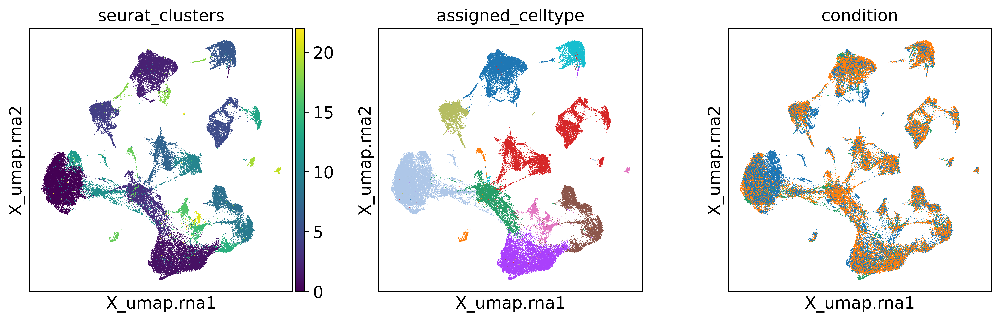

In [6]:
#visualise RNA embeddings
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.embedding(rna_data,basis='X_umap.rna', color=['seurat_clusters', 'assigned_celltype', 'condition'],legend_loc='on_data')

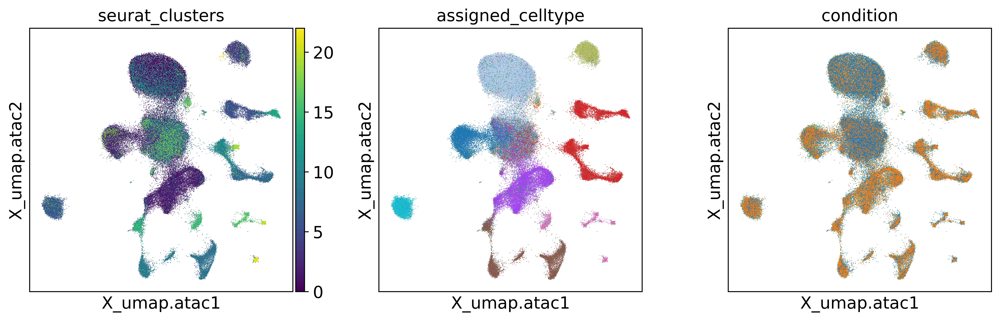

In [7]:
#visualise ATAC embeddings
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.embedding(atac_data,basis='X_umap.atac', color=['seurat_clusters', 'assigned_celltype', 'condition'],legend_loc='on_data')

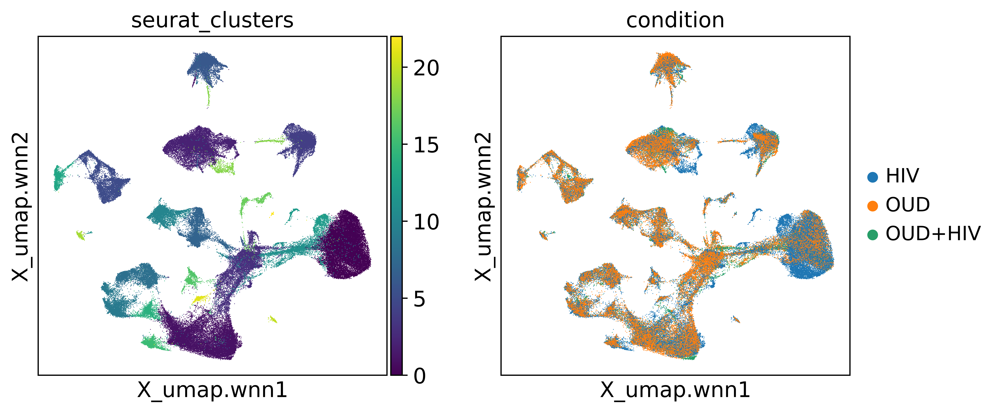

In [12]:
#visualise combined RNA+ATAC embeddings
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.embedding(rna_data,basis='X_umap.wnn', color=['seurat_clusters','condition'])

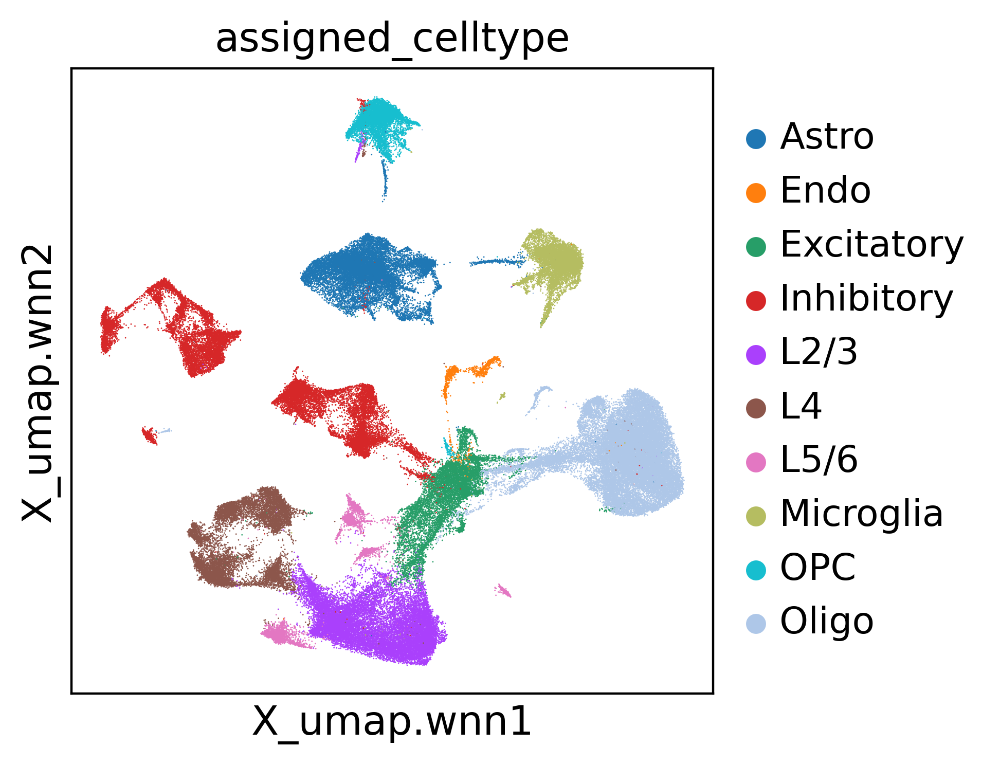

In [18]:
#visualise granular labels
#make white background
sc.set_figure_params(facecolor='w')
sc.set_figure_params(figsize=(5,3))
sc.set_figure_params(dpi=200)
sc.pl.embedding(rna_data,basis='X_umap.wnn', color=['assigned_celltype'])

# Manual granular clustering + marker gene detection

In [14]:
#access metadata of pfc
#list all column names
colnames(pfc[[]])

[1] "orig.ident"                        "nCount_RNA"                       
 [3] "nFeature_RNA"                      "percent.mt"                       
 [5] "nCount_RNA_raw"                    "nFeature_RNA_raw"                 
 [7] "nCount_ATAC"                       "nFeature_ATAC"                    
 [9] "gex_raw_reads"                     "gex_mapped_reads"                 
[11] "gex_conf_intergenic_reads"         "gex_conf_exonic_reads"            
[13] "gex_conf_intronic_reads"           "gex_conf_exonic_unique_reads"     
[15] "gex_conf_exonic_antisense_reads"   "gex_conf_exonic_dup_reads"        
[17] "gex_exonic_umis"                   "gex_conf_intronic_unique_reads"   
[19] "gex_conf_intronic_antisense_reads" "gex_conf_intronic_dup_reads"      
[21] "gex_intronic_umis"                 "gex_conf_txomic_unique_reads"     
[23] "gex_umis_count"                    "gex_genes_count"                  
[25] "atac_raw_reads"                    "atac_unmapped_reads"              
[27] "atac_lowmapq"                      "atac_dup_reads"                   
[29] "atac_chimeric_reads"               "atac_mitochondrial_reads"         
[31] "atac_fragments"                    "atac_TSS_fragments"               
[33] "atac_peak_region_fragments"        "atac_peak_region_cutsites"        
[35] "TSS.enrichment"                    "TSS.percentile"                   
[37] "nCount_SCT"                        "nFeature_SCT"                     
[39] "SCT.weight"                        "ATAC.weight"                      
[41] "wsnn_res.0.2"                      "seurat_clusters"                  
[43] "log_nCount_ATAC"                   "log_nCount_SCT"                   
[45] "log_nFeature_ATAC"                 "log_nFeature_SCT"                 
[47] "library"                           "wsnn_res.0.25"                    
[49] "remove_cells"                      "sub.cluster"                      
[51] "value"                             "assigned_celltype"                
[53] "condition"                         "predicted.id"                     
[55] "prediction.score.V1"               "prediction.score.VIP"             
[57] "prediction.score.LAMP5"            "prediction.score.IT"              
[59] "prediction.score.PAX6"             "prediction.score.Oligodendrocyte" 
[61] "prediction.score.Astrocyte"        "prediction.score.L5.6.NP"         
[63] "prediction.score.SST"              "prediction.score.L6.CT"           
[65] "prediction.score.OPC"              "prediction.score.PVALB"           
[67] "prediction.score.L6b"              "prediction.score.Microglia"       
[69] "prediction.score.L5.ET"            "prediction.score.Pericyte"        
[71] "prediction.score.Endothelial"      "prediction.score.L4.IT"           
[73] "prediction.score.VLMC"             "prediction.score.max"

[[1]]

[[2]]


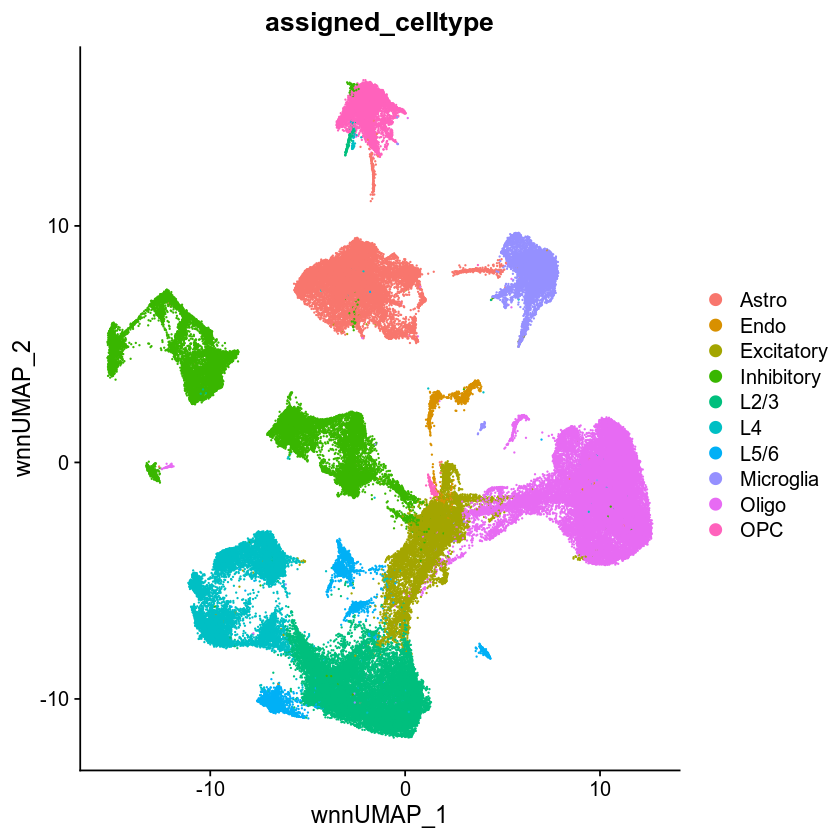

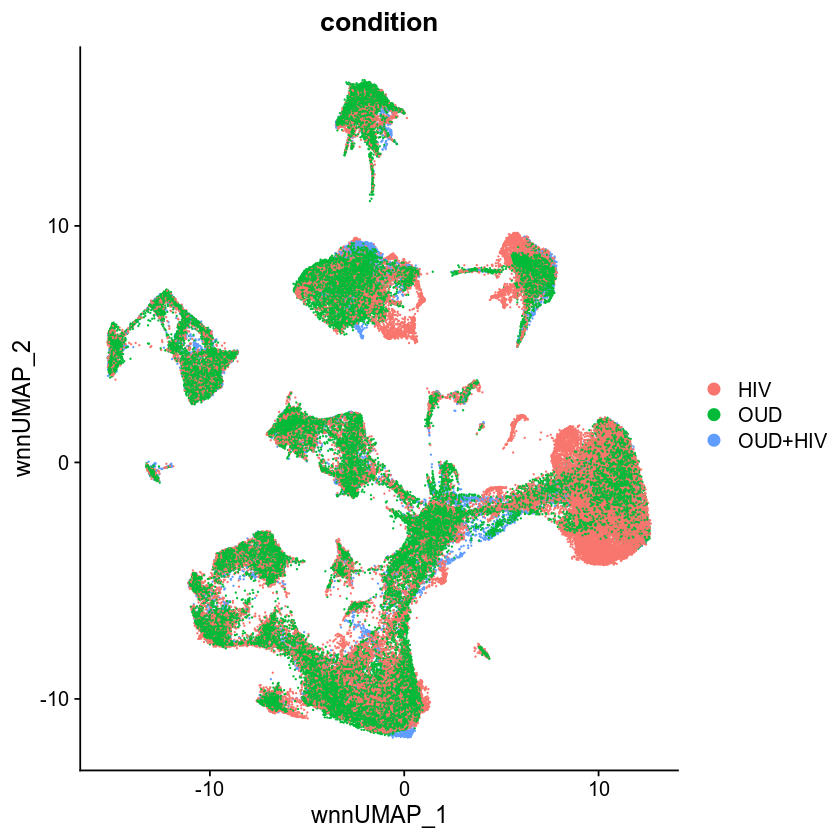

In [36]:
#visualise coarse labels
DimPlot(pfc, reduction = "umap.wnn", group.by = c('assigned_celltype', 'condition'), raster=FALSE, combine=FALSE)


In [3]:
# Subset data into different objects
# excitatory, Inhibitory, oligo, astro, oligo, OPC
pfc_exc <- subset(x = pfc, subset = assigned_celltype == c("Excitatory", 'L2/3', 'L4', 'L5/6'))
# pfc_inh <- subset(x = pfc, subset = assigned_celltype == "Inhibitory")
# pfc_ast <- subset(x = pfc, subset = assigned_celltype == "Astro")
# pfc_oli <- subset(x = pfc, subset = assigned_celltype == "Oligo")
# pfc_opc <- subset(x = pfc, subset = assigned_celltype == "OPC")
# pfc_mcg <- subset(x = pfc, subset = assigned_celltype == "Microglia")


Loading required package: Signac



Warning message in assigned_celltype == c("Excitatory", "L2/3", "L4", "L5/6"):
“longer object length is not a multiple of shorter object length”


In [4]:
curr = pfc_exc

In [5]:
#Excitatory
DefaultAssay(curr) <- 'RNA'
curr <- NormalizeData(curr) %>% FindVariableFeatures() %>% ScaleData()
curr <- RunPCA(curr, features=VariableFeatures(object = curr), npcs=20, reduction.name='sub.pca.rna')




In [ ]:
curr

Warning message:
“Transformation introduced infinite values in continuous x-axis”


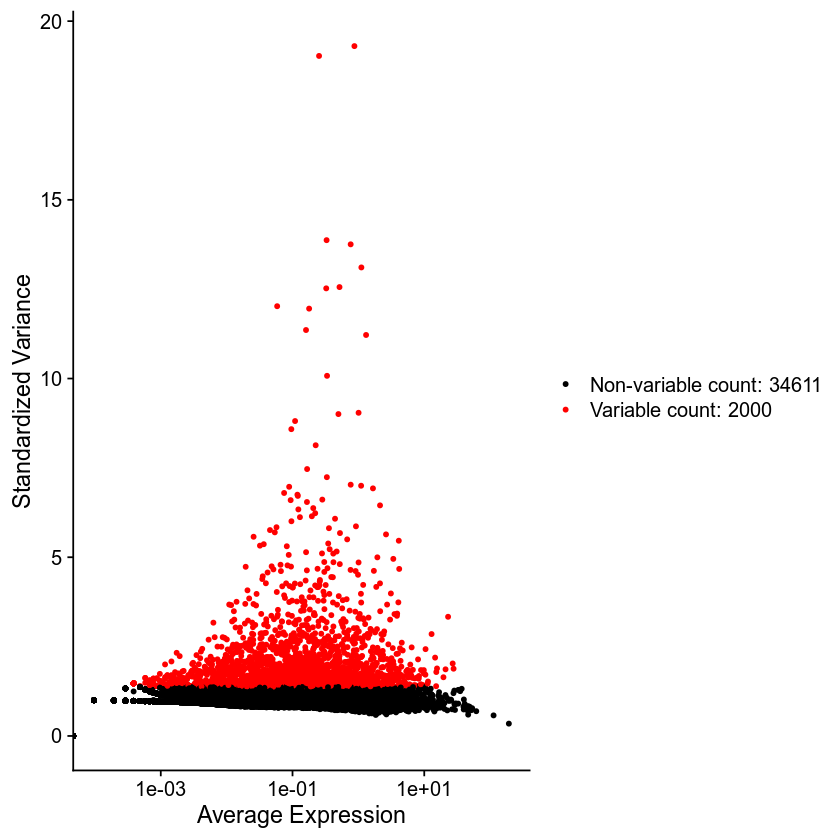

In [108]:
DefaultAssay(curr) <- 'ATAC'
curr <- NormalizeData(curr) %>% FindVariableFeatures() %>% ScaleData()
curr <- RunPCA(curr, features=VariableFeatures(object = curr), npcs=20, reduction.name='sub.pca.atac')

In [97]:
ElbowPlot

In [86]:
pfc_exc[["RNA"]]@data

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]



36611 x 10330 sparse Matrix of class "dgCMatrix"
                                                                                            
MIR1302-2HG   . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
FAM138A       . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
OR4F5         . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.1    . . .  1 .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.3    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.5    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  1  1  . . .  .  .  .  .  .  .
AL627309.4    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AP006222.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL732372.1    . . .  

In [84]:
#find max and min values
max(prac[["RNA"]]@data)
min(prac[["RNA"]]@data)


[1] 2220

[1] 0

In [69]:
prac[["RNA"]]@data

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]



36611 x 10330 sparse Matrix of class "dgCMatrix"
                                                                                            
MIR1302-2HG   . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
FAM138A       . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
OR4F5         . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.1    . . .  1 .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.3    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.5    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  1  1  . . .  .  .  .  .  .  .
AL627309.4    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AP006222.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL732372.1    . . .  

In [64]:
prac[["RNA"]]@data

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]



36611 x 10330 sparse Matrix of class "dgCMatrix"
                                                                                            
MIR1302-2HG   . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
FAM138A       . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
OR4F5         . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.1    . . .  1 .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.3    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.5    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  1  1  . . .  .  .  .  .  .  .
AL627309.4    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AP006222.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL732372.1    . . .  

ERROR: Error in parse(text = x, srcfile = src): <text>:2:0: unexpected end of input
1: np.ln?
   ^


In [77]:
#find max and min values
max(pfc[["RNA"]]@data)
min(pfc[["RNA"]]@data)


[1] 3952

[1] 0

In [60]:
pfc_exc[["RNA"]]@data

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]

  [[ suppressing 32 column names ‘CG103_PFC_hiv_AAACCGCGTCAAGTGC-1’, ‘CG103_PFC_hiv_AAACCGGCAGGCTAGA-1’, ‘CG103_PFC_hiv_AAAGCCCGTGTGAGAG-1’ ... ]]



36611 x 10330 sparse Matrix of class "dgCMatrix"
                                                                                            
MIR1302-2HG   . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
FAM138A       . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
OR4F5         . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.1    . . .  1 .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.3    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL627309.5    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  1  1  . . .  .  .  .  .  .  .
AL627309.4    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AP006222.2    . . .  . .   .  .  . .  .  .  .  .  .  . . .  .  .  .  . . .  .  .  .  .  .  .
AL732372.1    . . .  

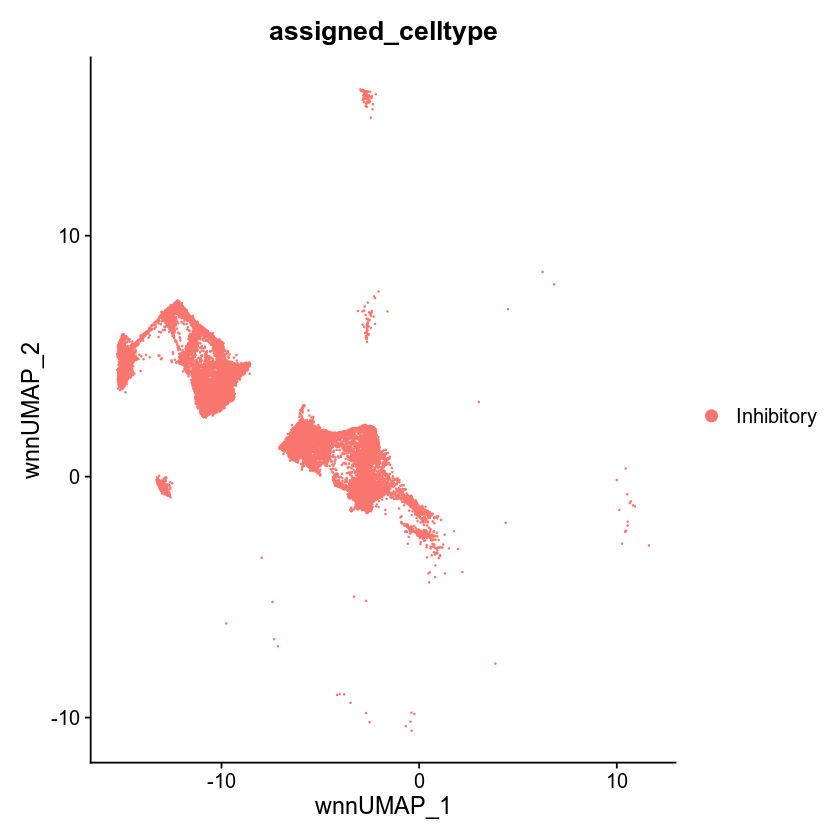

In [52]:
#Inhibitory
DimPlot(pfc_inh, reduction = "umap.wnn", group.by = c('assigned_celltype'), raster=FALSE)


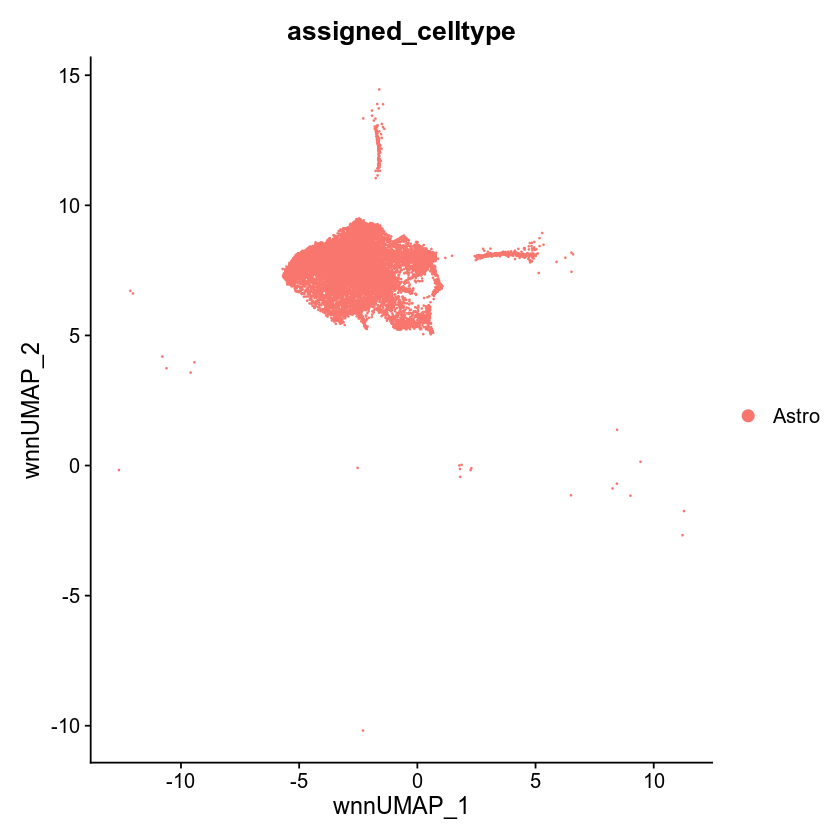

In [53]:
#Astrocytes
DimPlot(pfc_ast, reduction = "umap.wnn", group.by = c('assigned_celltype'), raster=FALSE)


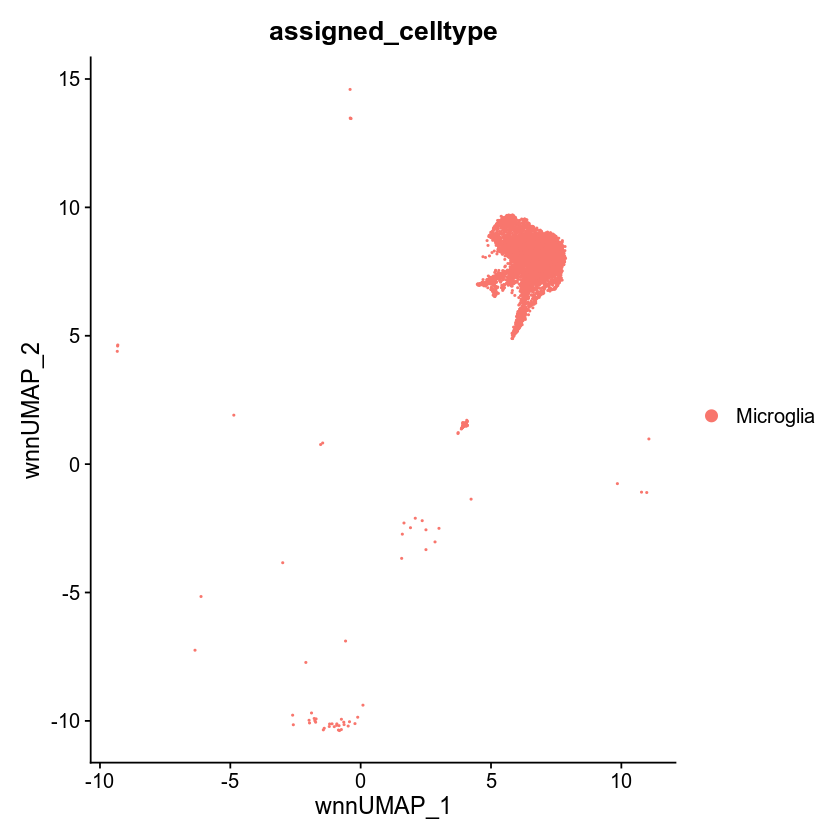

In [54]:
#Microglia
DimPlot(pfc_mcg, reduction = "umap.wnn", group.by = c('assigned_celltype'), raster=FALSE)


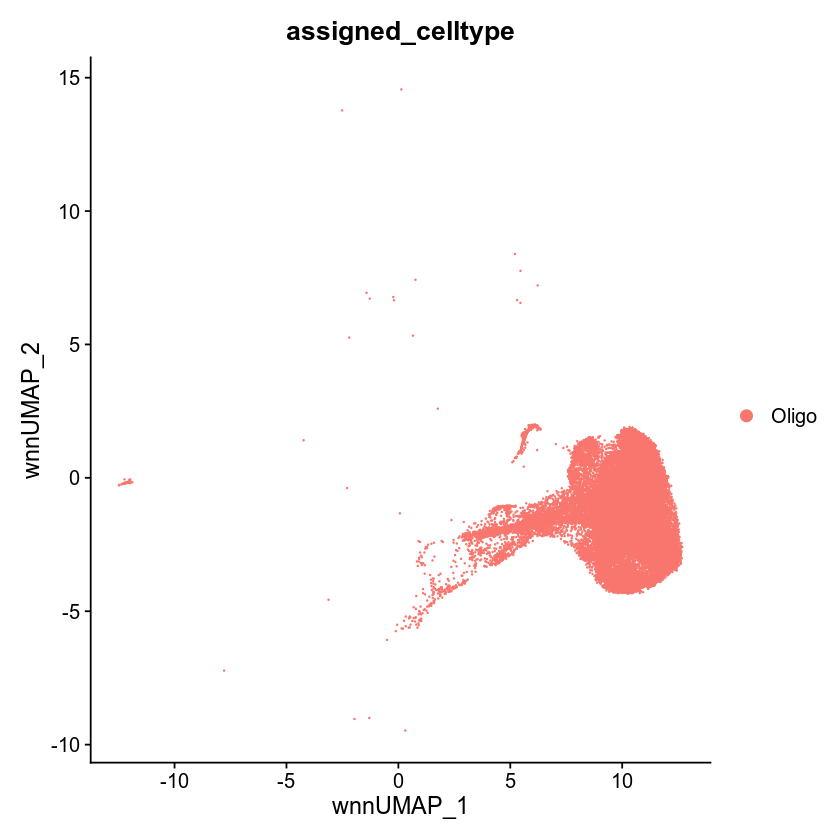

In [57]:
#Oligodendrocytes
DimPlot(pfc_oli, reduction = "umap.wnn", group.by = c('assigned_celltype'), raster=FALSE)


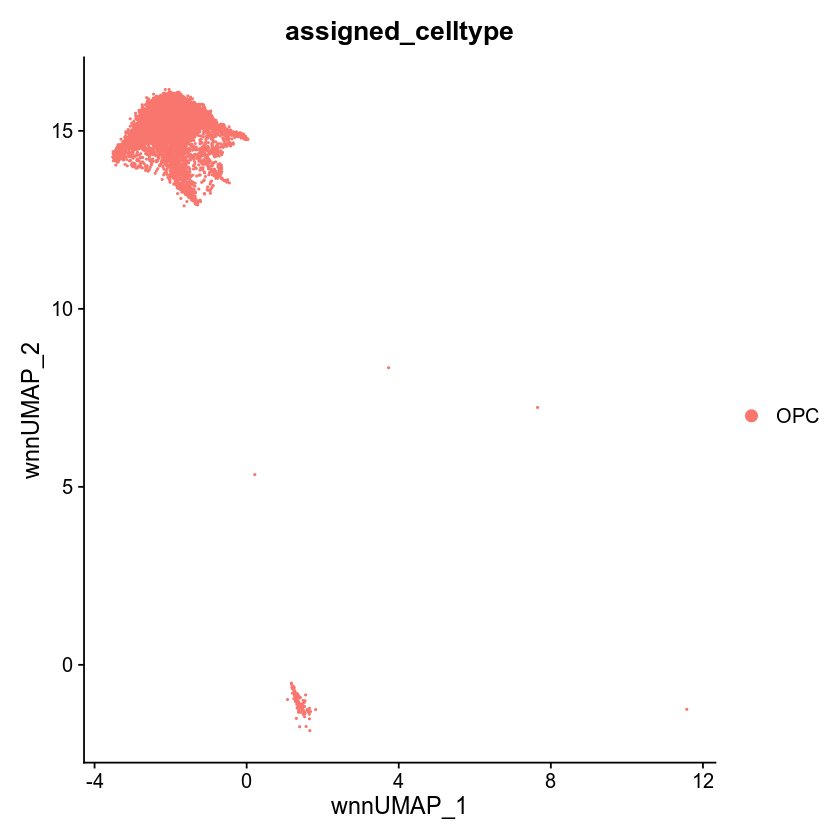

In [58]:
#OPC
DimPlot(pfc_opc, reduction = "umap.wnn", group.by = c('assigned_celltype'), raster=FALSE)


In [ ]:
# design class
# find high var genes, normalise?, set resolution, run clustering, run UMAP, find marker genes